<a href="https://colab.research.google.com/github/aisafepedia/DeepWorks/blob/main/train_detectron2_custom_dataset_v3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
%cd /content/drive/MyDrive/Geologging
!git clone https://github.com/facebookresearch/detectron2.git

Cloning into 'detectron2'...
remote: Enumerating objects: 15188, done.
remote: Counting objects: 100% (209/209), done.
remote: Compressing objects: 100% (140/140), done.
remote: Total 15188 (delta 118), reused 118 (delta 69), pack-reused 14979
Receiving objects: 100% (15188/15188), 6.21 MiB | 10.43 MiB/s, done.
Resolving deltas: 100% (10980/10980), done.
Updating files: 100% (820/820), done.


In [ ]:
!pip uninstall torch
# !pip install torch==1.10.0+cu113 torchvision==0.11.1+cu113 torchaudio==0.10.0+cu113 -f https://download.pytorch.org/whl/cu113/torch_stable.html

Found existing installation: torch 2.0.1+cu118
Uninstalling torch-2.0.1+cu118:
  Would remove:
    /usr/local/bin/convert-caffe2-to-onnx
    /usr/local/bin/convert-onnx-to-caffe2
    /usr/local/bin/torchrun
    /usr/local/lib/python3.10/dist-packages/functorch/*
    /usr/local/lib/python3.10/dist-packages/nvfuser/*
    /usr/local/lib/python3.10/dist-packages/torch-2.0.1+cu118.dist-info/*
    /usr/local/lib/python3.10/dist-packages/torch/*
    /usr/local/lib/python3.10/dist-packages/torchgen/*
Proceed (Y/n)? y
  Successfully uninstalled torch-2.0.1+cu118


In [ ]:
!pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118

Looking in indexes: https://download.pytorch.org/whl/cu118
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 GB 792.7 kB/s eta 0:00:00


In [ ]:
%cd /content/drive/MyDrive/Geologging
!pip install -e detectron2

/content/drive/MyDrive/Geologging
Obtaining file:///content/drive/MyDrive/Geologging/detectron2
  Preparing metadata (setup.py) ... done
  Attempting uninstall: detectron2
    Found existing installation: detectron2 0.6
    Uninstalling detectron2-0.6:
      Successfully uninstalled detectron2-0.6
  Running setup.py develop for detectron2


In [ ]:
# import torch
# TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
# CUDA_VERSION = torch.__version__.split("+")[-1]
# print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)

# !pip install pyyaml==5.1

# # Install detectron2 that matches the above pytorch version
# # See https://detectron2.readthedocs.io/tutorials/install.html for instructions
# # If there is not yet a detectron2 release that matches the given torch + CUDA version, you need to install a different pytorch.
# !pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/$CUDA_VERSION/torch$TORCH_VERSION/index.html

In [ ]:
!pip show detectron2

Name: detectron2
Version: 0.6
Summary: Detectron2 is FAIR's next-generation research platform for object detection and segmentation.
Home-page: https://github.com/facebookresearch/detectron2
Author: FAIR
Author-email: 
License: 
Location: /content/drive/MyDrive/Geologging/detectron2
Editable project location: /content/drive/MyDrive/Geologging/detectron2
Requires: black, cloudpickle, fvcore, hydra-core, iopath, matplotlib, omegaconf, packaging, Pillow, pycocotools, tabulate, tensorboard, termcolor, tqdm, yacs
Required-by: 


## JSON & Images Merger

In [ ]:
import os
import shutil
from natsort import natsorted
import json  # Tambahkan import ini

json_version = 1

main_folder = '/content/drive/MyDrive/Geologging/PTFI/Datasets/TEW'
items = natsorted(os.listdir(main_folder))
list_holeid = [item for item in items if os.path.isdir(os.path.join(main_folder, item))]
print(list_holeid)

target_folder = '/content/drive/MyDrive/Geologging/PTFI/Datasets/ready_to_train'
list_json_path = []

for holeid in list_holeid:
    path_holeid = os.path.join(main_folder, holeid)
    items_holeid = natsorted(os.listdir(path_holeid))
    images = [item_images for item_images in items_holeid if os.path.isdir(os.path.join(path_holeid, item_images))]
    json_files = [item_json for item_json in items_holeid if os.path.isfile(os.path.join(path_holeid, item_json))]

    images_path = os.path.join(path_holeid, images[0])
    json_path = os.path.join(path_holeid, json_files[0])
    list_json_path.append(json_path)

    for image in os.listdir(images_path):
        source_path = os.path.join(images_path, image)
        dest_path = os.path.join(target_folder, 'images')
        if not os.path.exists(dest_path):
            os.mkdir(dest_path)
        dest_path = os.path.join(dest_path, image)

        # Cek apakah file sudah ada di tujuan
        if not os.path.exists(dest_path):
            # Jika file tidak ada, maka salin
            shutil.copy(source_path, dest_path)
            print(f"File {image} copied.")
        else:
            # Jika file sudah ada, maka lewati
            print(f"File {image} already exists. Skipped")

# Buat struktur data kosong untuk menyimpan data COCO polygon gabungan
combined_data = {
    "info": [],
    "licenses": [],
    "images": [],
    "annotations": [],
    "categories": []
}

# Gabungkan data dari setiap file JSON ke dalam struktur data gabungan
for file_path in list_json_path:
    if os.path.isfile(file_path):  # Periksa apakah file JSON ada
        with open(file_path, 'r') as file:
            data = json.load(file)

            # Gabungkan data ke dalam struktur data gabungan
            combined_data["images"].extend(data["images"])
            combined_data["annotations"].extend(data["annotations"])
            combined_data["categories"].extend(data["categories"])

# Simpan data gabungan ke dalam file JSON baru
output_path = os.path.join(target_folder, 'json')
if not os.path.exists(output_path):
    os.mkdir(output_path)

output_path = os.path.join(output_path, f'annotation_v{json_version}.json')

with open(output_path, 'w') as output_file:
    json.dump(combined_data, output_file, indent=4)

print(f"File JSON gabungan telah disimpan di: {output_path}")


['TEW04-09', 'TEW04-11']
File TEW04-09 107.8 M - 110.8 M.JPG already exists. Skipped
File TEW04-09 14.1 M - 17.2 M.JPG already exists. Skipped
File TEW04-09 137.8 M - 140.8 M.JPG already exists. Skipped
File TEW04-09 155.8 M - 158.8 M.JPG already exists. Skipped
File TEW04-09 116.8 M - 122.8 M.JPG already exists. Skipped
File TEW04-09 164.8 M - 170.8 M.JPG already exists. Skipped
File TEW04-09 131.8 M - 137.8 M.JPG already exists. Skipped
File TEW04-09 113.8 M - 116.8 M.JPG already exists. Skipped
File TEW04-09 170.8 M - 173.8 M.JPG already exists. Skipped
File TEW04-09 128.8 M - 131.8 M.JPG already exists. Skipped
File TEW04-09 98.8 M - 101.8 M.JPG already exists. Skipped
File TEW04-09 101.8 M - 107.8 M.JPG already exists. Skipped
File TEW04-09 140.8 M - 143.8 M.JPG already exists. Skipped
File TEW04-09 152.8 M - 155.8 M.JPG already exists. Skipped
File TEW04-09 122.8 M - 125.8 M.JPG already exists. Skipped
File TEW04-09 143.8 M - 146.8 M.JPG already exists. Skipped
File TEW04-09 8.8 

## Dataset Spliter

In [ ]:
import os
import json
import random
from shutil import copyfile, rmtree

annotations_json = 'annotation_v1.json'

# Persentase pembagian dataset (misalnya 80% train, 20% val)
train_percentage = 0.8

# Path ke folder dataset awal
dataset_path = '/content/drive/MyDrive/Geologging/PTFI/Datasets/ready_to_train/'

annotations_file_path = os.path.join(dataset_path, 'json', annotations_json)
images_path = os.path.join(dataset_path, 'images')

# Path untuk menyimpan dataset train dan val
output_train_path = os.path.join(dataset_path, 'train')
output_val_path = os.path.join(dataset_path, 'val')

# Path untuk menyimpan file JSON train dan val
train_json_path = os.path.join(dataset_path, 'train.json')
val_json_path = os.path.join(dataset_path, 'val.json')

# Hapus file JSON jika sudah ada
for json_path in [train_json_path, val_json_path]:
    if os.path.exists(json_path):
        os.remove(json_path)

# Hapus konten folder jika sudah ada
for folder_path in [output_train_path, output_val_path]:
    if os.path.exists(folder_path):
        rmtree(folder_path)

# Membuat folder output jika belum ada
os.makedirs(output_train_path, exist_ok=True)
os.makedirs(output_val_path, exist_ok=True)

# Load informasi dari file anotasi JSON
with open(annotations_file_path, 'r') as f:
    annotations_data = json.load(f)

# Ambil daftar nama gambar dari file anotasi
image_entries = annotations_data['images']
random.shuffle(image_entries)

# Hitung jumlah data untuk train dan val
num_train = int(len(image_entries) * train_percentage)
train_entries = image_entries[:num_train]
val_entries = image_entries[num_train:]

# Fungsi untuk mengcopy file gambar
def copy_images(entries, source_dir, destination_dir):
    for entry in entries:
        filename = entry['file_name']
        image_path = os.path.join(source_dir, filename)
        destination_image_path = os.path.join(destination_dir, filename)
        copyfile(image_path, destination_image_path)

# Copy data train dan val ke folder output
copy_images(train_entries, images_path, output_train_path)
copy_images(val_entries, images_path, output_val_path)

# Buat file JSON train
train_json_data = {
    'images': train_entries,
    'annotations': annotations_data['annotations'],  # Sesuaikan dengan struktur yang tepat
    'categories': annotations_data['categories']  # Sesuaikan dengan struktur yang tepat
}
with open(train_json_path, 'w') as f:
    json.dump(train_json_data, f)

# Buat file JSON val
val_json_data = {
    'images': val_entries,
    'annotations': annotations_data['annotations'],  # Sesuaikan dengan struktur yang tepat
    'categories': annotations_data['categories']  # Sesuaikan dengan struktur yang tepat
}
with open(val_json_path, 'w') as f:
    json.dump(val_json_data, f)

print("Images and JSON files split and copied successfully!")


Images and JSON files split and copied successfully!


## Preprocessing

In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.data.datasets import register_coco_instances

In [ ]:
def plotImage(image, cmap='viridis', title=None, fontsize=35, figsize=(15,7)):
    if cmap != 'binary_r' and cmap != 'gray':
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=figsize)
    plt.axis("off")
    if title:
        plt.title(label=title, fontsize=fontsize)
    plt.imshow(image, cmap=cmap)
    plt.tight_layout()
    plt.show()

In [ ]:
# if your dataset is in COCO format:
dataset_path = '/content/drive/MyDrive/Geologging/PTFI/Datasets/Full Core_TEW 04-09'
register_coco_instances("my_dataset_train", {},
                        os.path.join(dataset_path,"train.json"),
                        os.path.join(dataset_path,"images"),
                        )

register_coco_instances("my_dataset_val", {},
                        os.path.join(dataset_path,"val.json"),
                        os.path.join(dataset_path,"images"),
                        )

In [ ]:
metadata_train = MetadataCatalog.get('my_dataset_train')
metadata_val = MetadataCatalog.get('my_dataset_val')
print(metadata_train)
print(metadata_val)

Metadata(name='my_dataset_train', json_file='/content/drive/MyDrive/Geologging/PTFI/Datasets/Full Core_TEW 04-09/train.json', image_root='/content/drive/MyDrive/Geologging/PTFI/Datasets/Full Core_TEW 04-09/images', evaluator_type='coco')
Metadata(name='my_dataset_val', json_file='/content/drive/MyDrive/Geologging/PTFI/Datasets/Full Core_TEW 04-09/val.json', image_root='/content/drive/MyDrive/Geologging/PTFI/Datasets/Full Core_TEW 04-09/images', evaluator_type='coco')


WARNING [08/18 04:05:58 d2.data.datasets.coco]: /content/drive/MyDrive/Geologging/PTFI/Datasets/Full Core_TEW 04-09/train.json contains 812 annotations, but only 641 of them match to images in the file.
[08/18 04:05:58 d2.data.datasets.coco]: Loaded 38 images in COCO format from /content/drive/MyDrive/Geologging/PTFI/Datasets/Full Core_TEW 04-09/train.json

Image Path	: /content/drive/MyDrive/Geologging/PTFI/Datasets/Full Core_TEW 04-09/images/68.80 M - 74.80 M.JPG
Image Shape	: (1949, 5259, 3)
Total		: 16


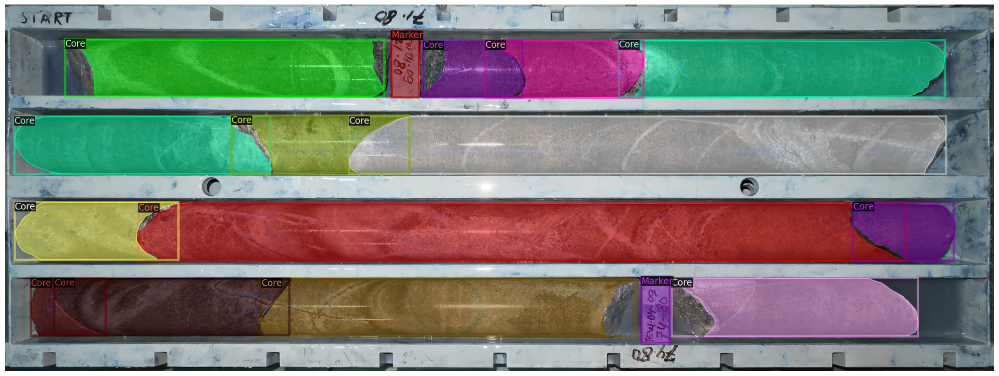


Image Path	: /content/drive/MyDrive/Geologging/PTFI/Datasets/Full Core_TEW 04-09/images/161.80 M - 164.80 M.JPG
Image Shape	: (1968, 5300, 3)
Total		: 19


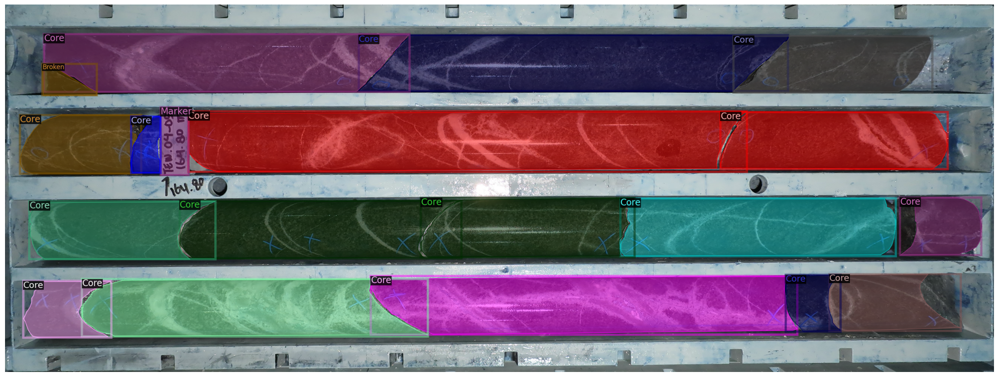


Image Path	: /content/drive/MyDrive/Geologging/PTFI/Datasets/Full Core_TEW 04-09/images/89.80 M - 92.80 M.JPG
Image Shape	: (1932, 5254, 3)
Total		: 12


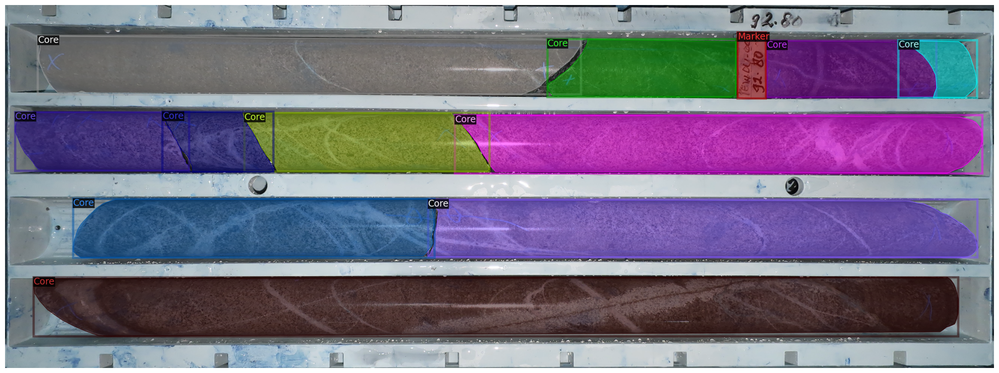

In [ ]:
# Show data training
dataset_train_dicts = DatasetCatalog.get("my_dataset_train")
for d in random.sample(dataset_train_dicts, 3):
    img = cv2.imread(d["file_name"])
    print('\nImage Path\t: {}'.format(d['file_name']))
    print('Image Shape\t: {}'.format(img.shape))
    visualizer = Visualizer(img[:, :, ::-1], metadata=metadata_train, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    print('Total\t\t: {}'.format(len(d['annotations'])))
    plotImage(out.get_image(), figsize=(20,10))

WARNING [08/18 04:06:41 d2.data.datasets.coco]: /content/drive/MyDrive/Geologging/PTFI/Datasets/Full Core_TEW 04-09/val.json contains 812 annotations, but only 171 of them match to images in the file.
[08/18 04:06:41 d2.data.datasets.coco]: Loaded 10 images in COCO format from /content/drive/MyDrive/Geologging/PTFI/Datasets/Full Core_TEW 04-09/val.json

Image Path	: /content/drive/MyDrive/Geologging/PTFI/Datasets/Full Core_TEW 04-09/images/140.80 M - 143.80 M.JPG
Image Shape	: (1949, 5260, 3)
Total		: 11


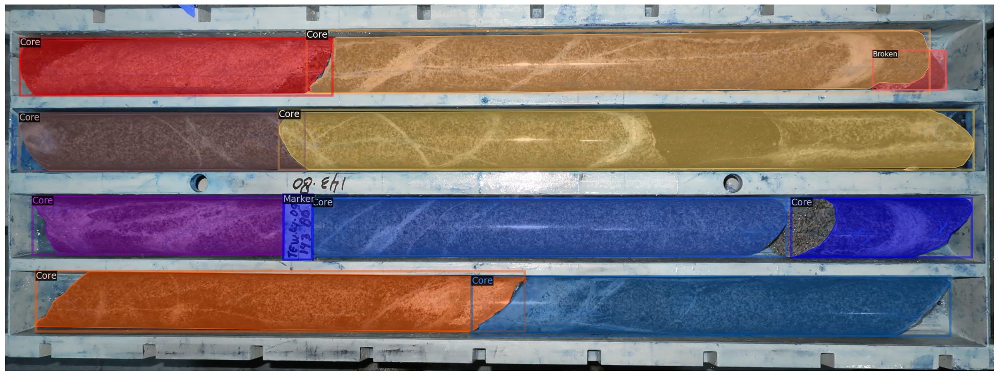


Image Path	: /content/drive/MyDrive/Geologging/PTFI/Datasets/Full Core_TEW 04-09/images/92.80 M - 95.80 M.JPG
Image Shape	: (1939, 5297, 3)
Total		: 16


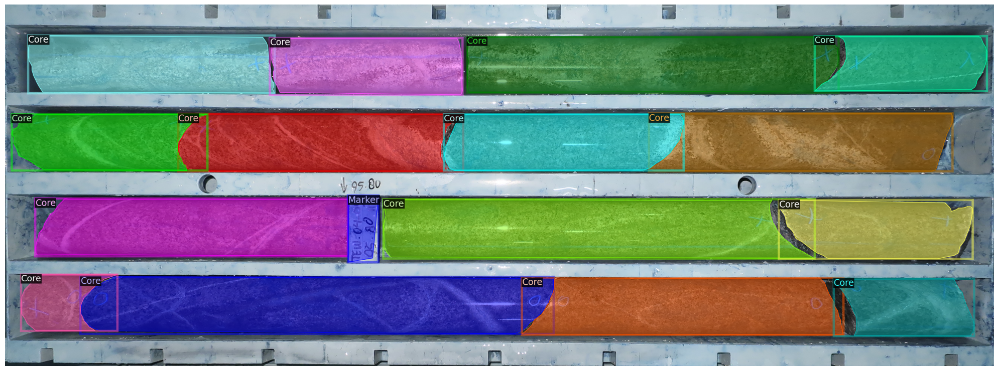


Image Path	: /content/drive/MyDrive/Geologging/PTFI/Datasets/Full Core_TEW 04-09/images/128.80 M - 131.80 M.JPG
Image Shape	: (1936, 5267, 3)
Total		: 17


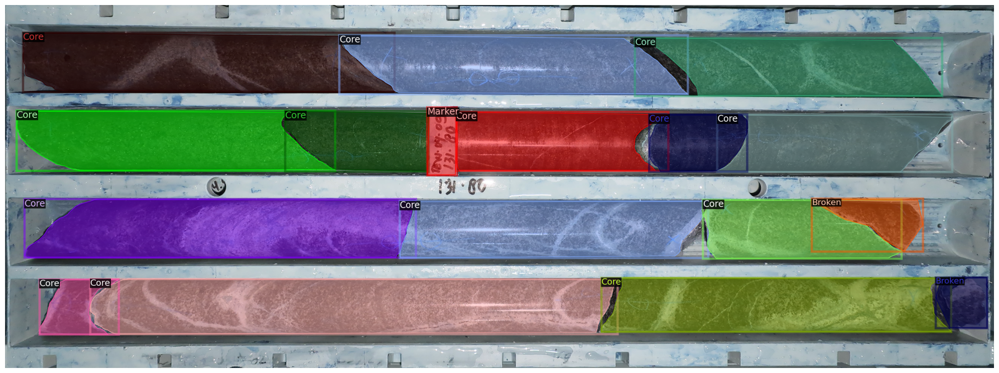

In [ ]:
# Show data validation
dataset_train_dicts = DatasetCatalog.get("my_dataset_val")
for d in random.sample(dataset_train_dicts, 3):
    img = cv2.imread(d["file_name"])
    print('\nImage Path\t: {}'.format(d['file_name']))
    print('Image Shape\t: {}'.format(img.shape))
    visualizer = Visualizer(img[:, :, ::-1], metadata=metadata_val, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    print('Total\t\t: {}'.format(len(d['annotations'])))
    plotImage(out.get_image(), figsize=(20,10))

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val")
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 10000     # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []         # do not decay learning rate
# cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4  #(see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.
cfg.OUTPUT_DIR = '/content/drive/MyDrive/Geologging/PTFI/Models/logs_training/Core_TEW 04-09_v2'

cfg.SOLVER.CHECKPOINT_PERIOD = 2000
cfg.MODEL.RPN.POST_NMS_TOPK_TEST  = 10000 # originally 1000
cfg.MODEL.RPN.PRE_NMS_TOPK_TEST   = 10000 # originally 1000
cfg.MODEL.RPN.POST_NMS_TOPK_TRAIN = 10000 # originally 1000
cfg.MODEL.RPN.PRE_NMS_TOPK_TRAIN  = 10000 # originally 1000

print(cfg)

CUDNN_BENCHMARK: False
DATALOADER:
  ASPECT_RATIO_GROUPING: True
  FILTER_EMPTY_ANNOTATIONS: True
  NUM_WORKERS: 2
  REPEAT_THRESHOLD: 0.0
  SAMPLER_TRAIN: TrainingSampler
DATASETS:
  PRECOMPUTED_PROPOSAL_TOPK_TEST: 1000
  PRECOMPUTED_PROPOSAL_TOPK_TRAIN: 2000
  PROPOSAL_FILES_TEST: ()
  PROPOSAL_FILES_TRAIN: ()
  TEST: my_dataset_val
  TRAIN: ('my_dataset_train',)
GLOBAL:
  HACK: 1.0
INPUT:
  CROP:
    ENABLED: False
    SIZE: [0.9, 0.9]
    TYPE: relative_range
  FORMAT: BGR
  MASK_FORMAT: polygon
  MAX_SIZE_TEST: 1333
  MAX_SIZE_TRAIN: 1333
  MIN_SIZE_TEST: 800
  MIN_SIZE_TRAIN: (640, 672, 704, 736, 768, 800)
  MIN_SIZE_TRAIN_SAMPLING: choice
  RANDOM_FLIP: horizontal
MODEL:
  ANCHOR_GENERATOR:
    ANGLES: [[-90, 0, 90]]
    ASPECT_RATIOS: [[0.5, 1.0, 2.0]]
    NAME: DefaultAnchorGenerator
    OFFSET: 0.0
    SIZES: [[32], [64], [128], [256], [512]]
  BACKBONE:
    FREEZE_AT: 2
    NAME: build_resnet_fpn_backbone
  DEVICE: cuda
  FPN:
    FUSE_TYPE: sum
    IN_FEATURES: ['res2', 're

## Training

In [ ]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=True)
trainer.train()

[08/18 04:09:56 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[08/18 04:09:56 d2.engine.train_loop]: Starting training from iteration 0
[08/18 04:10:27 d2.utils.events]:  eta: 4:15:58  iter: 19  total_loss: 5.055  loss_cls: 1.549  loss_box_reg: 0.9607  loss_mask: 0.6949  loss_rpn_cls: 1.405  loss_rpn_loc: 0.464    time: 1.5380  last_time: 1.5461  data_time: 0.0347  last_data_time: 0.0041   lr: 4.9953e-06  max_mem: 5921M
[08/18 04:10:59 d2.utils.events]:  eta: 4:18:17  iter: 39  total_loss: 3.789  loss_cls: 1.429  loss_box_reg: 0.9851  loss_mask: 0.6866  loss_rpn_cls: 0.3168  loss_rpn_loc: 0.3808    time: 1.5519  last_time: 1.5797  data_time: 0.0050  last_data_time: 0.0051   lr: 9.9902e-06  max_mem: 5922M
[08/18 04:11:30 d2.utils.events]:  eta: 4:19:15  iter: 59  total_loss: 3.347  loss_cls: 1.244  loss_box_reg: 0.974  loss_mask: 0.6669  loss_rpn_cls: 0.1394  loss_rpn_loc: 0.3362    time: 1.5649  last_time: 1.6088  data_time: 0.0053  last_data_time: 0.0058   lr: 1.4985e-05  max_mem: 5923M
[08/18 04:12:02 d2.utils.events]:  eta: 4:20:52  iter: 79  

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/content/drive/MyDrive/Geologging/detectron2/detectron2/engine/train_loop.py", line 155, in train
  File "/content/drive/MyDrive/Geologging/detectron2/detectron2/engine/defaults.py", line 494, in run_step
  File "/content/drive/MyDrive/Geologging/detectron2/detectron2/engine/train_loop.py", line 297, in run_step
  File "/content/drive/MyDrive/Geologging/detectron2/detectron2/data/common.py", line 329, in __iter__
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 633, in __next__
    data = self._next_data()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1345, in _next_data
    return self._process_data(data)
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1371, in _process_data
    data.reraise()
  File "/usr/local/lib/python3.10/dist-packages/torch/_utils.py", line 644, in reraise
    raise exception
FileNotFoundError: Caught FileN

## Validation

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/PythonCode/Detectron2/logs_training/mineral_realcase_v5_2class_filter_mask_rcnn_X_101_32x8d_FPN_3x

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
cfg.TEST.DETECTIONS_PER_IMAGE = 10000
cfg.MODEL.DEVICE = 'cuda'
predictor = DefaultPredictor(cfg)

[02/25 04:25:37 d2.data.datasets.coco]: Loaded 10 images in COCO format from /content/drive/MyDrive/Datasets/Mineral/annotations/GCA-Realcase-V5-2Class.json

Image Path	: /content/drive/MyDrive/Datasets/Mineral/images_filter/clahe/907 fraksi-100-2063-26-2.jpg
Image Shape	: (960, 1224, 3)


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


total		: 735


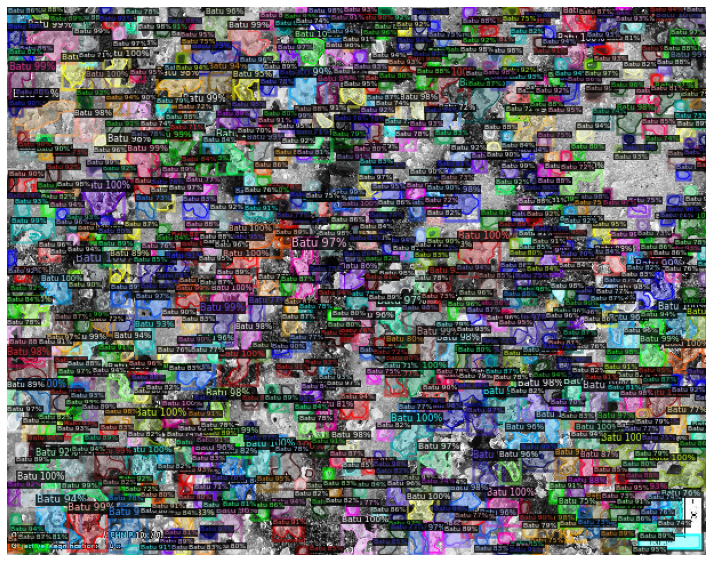


Image Path	: /content/drive/MyDrive/Datasets/Mineral/images_filter/clahe/906 fraksi-100-2063-26.jpg
Image Shape	: (960, 1224, 3)
total		: 1028


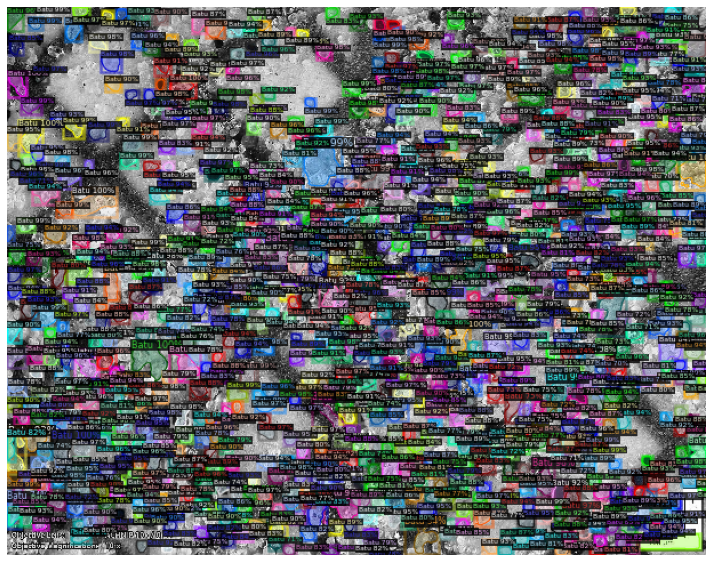


Image Path	: /content/drive/MyDrive/Datasets/Mineral/images_filter/clahe/904 fraksi-48-2063-26.jpg
Image Shape	: (960, 1224, 3)
total		: 752


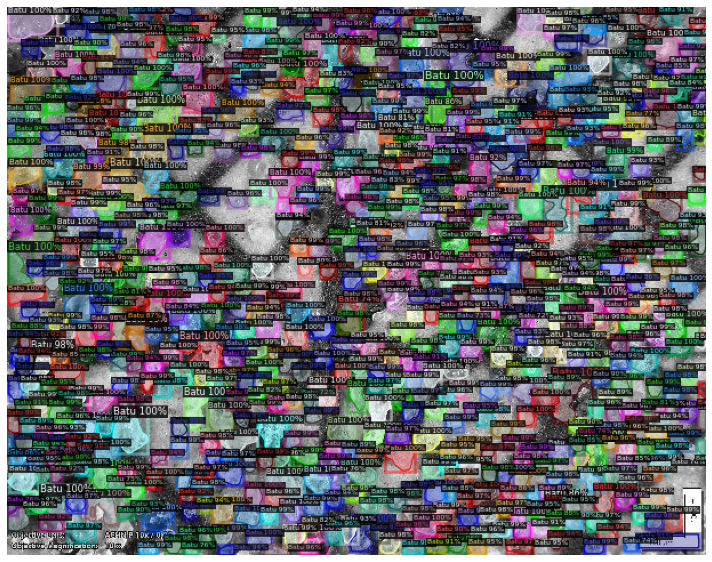


Image Path	: /content/drive/MyDrive/Datasets/Mineral/images_filter/clahe/901 aluvial_darat_fraksi-100.jpg
Image Shape	: (960, 1224, 3)
total		: 459


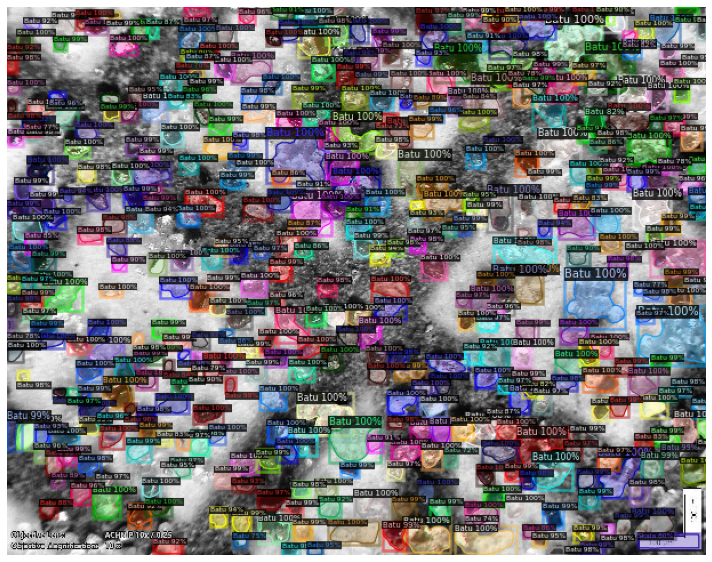


Image Path	: /content/drive/MyDrive/Datasets/Mineral/images_filter/clahe/914 nudur_utara__4.jpg
Image Shape	: (960, 1224, 3)
total		: 154


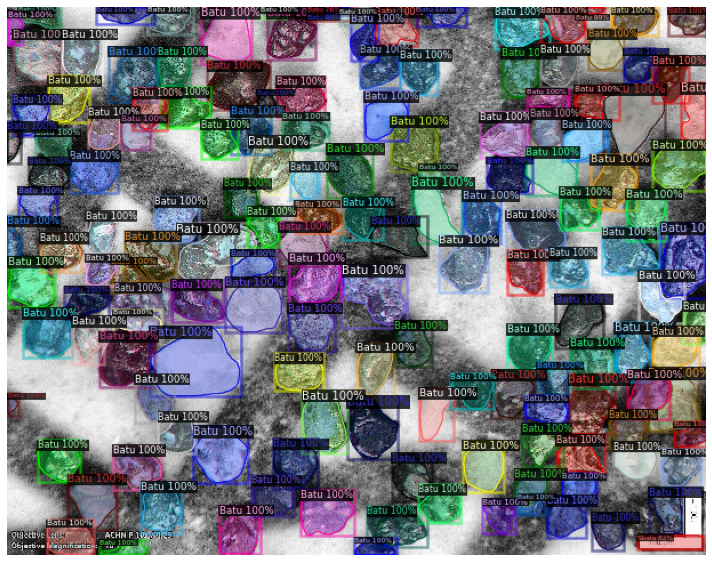


Image Path	: /content/drive/MyDrive/Datasets/Mineral/images_filter/clahe/902 fraksi48.jpg
Image Shape	: (960, 1224, 3)
total		: 925


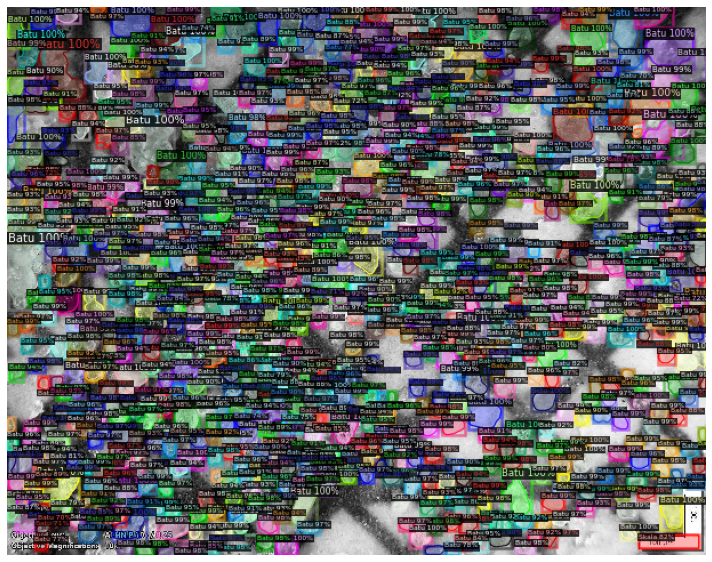


Image Path	: /content/drive/MyDrive/Datasets/Mineral/images_filter/clahe/804 bghijau_laut_balembang2.jpg
Image Shape	: (1200, 1600, 3)
total		: 362


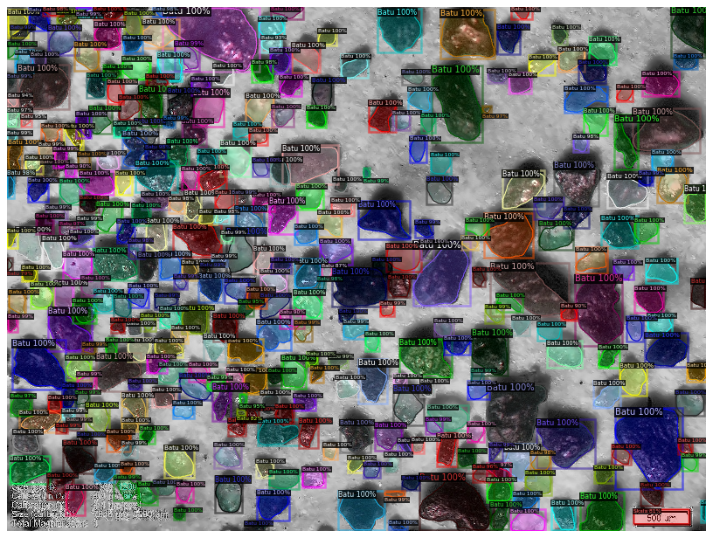


Image Path	: /content/drive/MyDrive/Datasets/Mineral/images_filter/clahe/903 fraksi-48.jpg
Image Shape	: (960, 1224, 3)
total		: 216


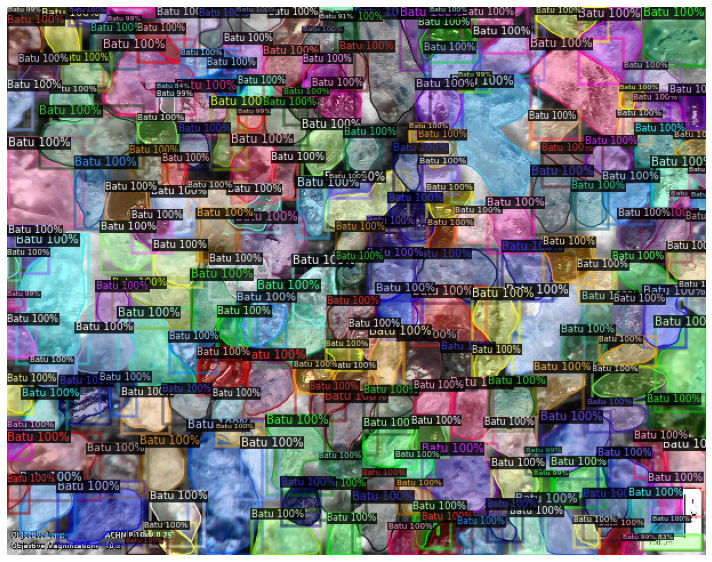


Image Path	: /content/drive/MyDrive/Datasets/Mineral/images_filter/clahe/803 bghijau_laut_balembang.jpg
Image Shape	: (1200, 1600, 3)
total		: 151


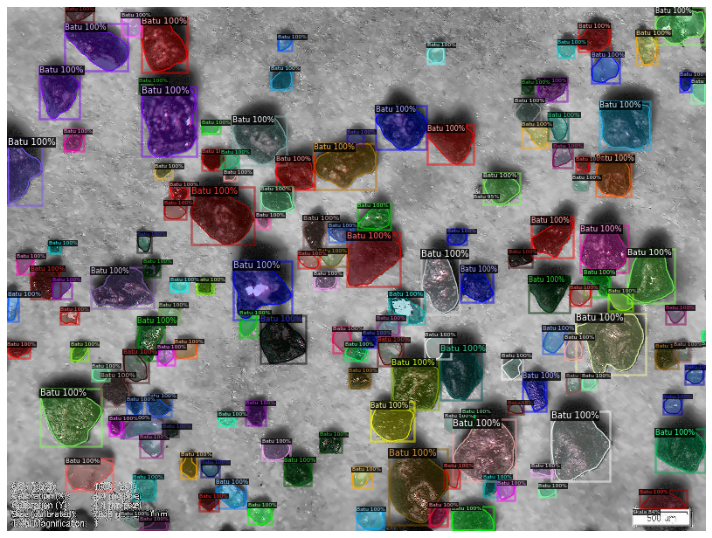


Image Path	: /content/drive/MyDrive/Datasets/Mineral/images_filter/clahe/917 nudur_utara_7.jpg
Image Shape	: (960, 1224, 3)
total		: 172


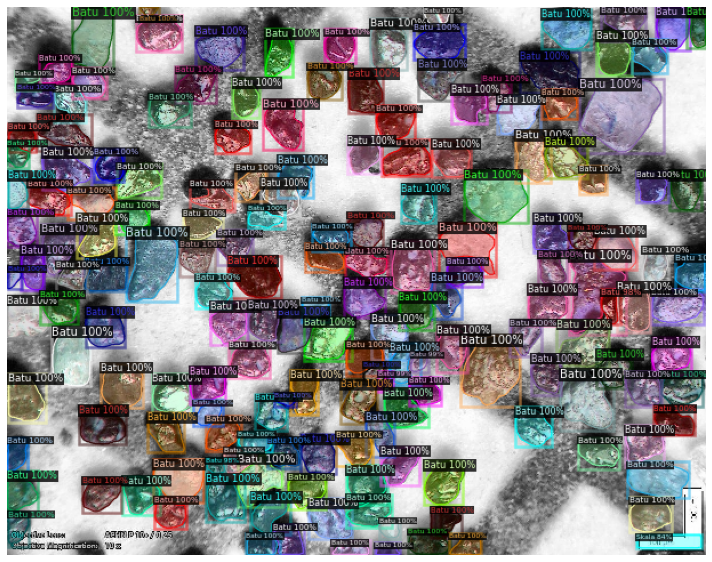

In [ ]:
dataset_val_dicts = DatasetCatalog.get("my_dataset_val")
for d in random.sample(dataset_val_dicts, 10):
    im = cv2.imread(d["file_name"])
    print('\nImage Path\t: {}'.format(d['file_name']))
    print('Image Shape\t: {}'.format(im.shape))

    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=dataset_metadata,
                   scale=0.5,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    print('total\t\t: {}'.format(len(outputs["instances"].to("cpu"))))
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    # cv2_imshow(out.get_image()[:, :, ::-1])
    plotImage(out.get_image(), figsize=(10,10))

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("my_dataset_val", output_dir=cfg.OUTPUT_DIR)
val_loader = build_detection_test_loader(cfg, "my_dataset_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

[02/25 04:29:12 d2.data.datasets.coco]: Loaded 10 images in COCO format from /content/drive/MyDrive/Datasets/Mineral/annotations/GCA-Realcase-V5-2Class.json
[02/25 04:29:12 d2.data.build]: Distribution of instances among all 2 categories:
|  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|
|    Batu    | 5653         |   Skala    | 10           |
|            |              |            |              |
|   total    | 5663         |            |              |
[02/25 04:29:12 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[02/25 04:29:12 d2.data.common]: Serializing 10 elements to byte tensors and concatenating them all ...
[02/25 04:29:12 d2.data.common]: Serialized dataset takes 1.95 MiB
[02/25 04:29:12 d2.evaluation.evaluator]: Start inference on 10 batches


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


[02/25 04:30:01 d2.evaluation.evaluator]: Total inference time: 0:00:21.691831 (4.338366 s / iter per device, on 1 devices)
[02/25 04:30:01 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:14 (2.874193 s / iter per device, on 1 devices)
[02/25 04:30:03 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[02/25 04:30:03 d2.evaluation.coco_evaluation]: Saving results to /content/drive/MyDrive/PythonCode/Detectron2/logs_training/mineral_realcase_v5_2class_filter_mask_rcnn_X_101_32x8d_FPN_3x/coco_instances_results.json
[02/25 04:30:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.01s)
creating index...
index created!
[02/25 04:30:05 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[02/25 04:30:05 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.16 seconds.
[02/25 04:30:05 d2.evaluation.fast_eval_api]: Accumulating evaluation results...
[02/25 04

### Run Inference

In [ ]:
import natsort
import time
import cv2
import warnings
warnings.filterwarnings("ignore")

directory = '/content/drive/MyDrive/Datasets/Mineral/images'
filename = natsort.natsorted(os.listdir(directory))
# filename = ['WhatsApp Image 2021-12-27 at 6.48.15 PM.jpeg']

for f in filename:
    img_path = os.path.join(directory, f)
    # img_path = f['file_name']
    origImg  = cv2.imread(img_path)
    print('\nfile name\t: {}'.format(f))
    print('image shape\t: {}'.format(origImg.shape))
    disImg = origImg.copy()

    stime = time.time()
    outputs = predictor(origImg)
    outputs = outputs['instances'].to('cpu')
    print('total\t\t: {}'.format(len(outputs)))

    for i in range(len(outputs)):
        mask = outputs.pred_masks[i].numpy()
        boxes = outputs.pred_boxes.tensor[i].numpy()
        cls_id = outputs.pred_classes[i].numpy()
        score = outputs.scores[i].numpy()

        mask_img = np.zeros(mask.shape, dtype='uint8')
        mask_img[mask] = 1
        contours = cv2.findContours(mask_img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        contours = contours[0] if len(contours) == 2 else contours[1]
        if len(contours) == 0:
            continue
        cnt = np.fliplr(contours[0])

        area = cv2.contourArea(cnt)
        x, y, w, h = cv2.boundingRect(cnt)
        M = cv2.moments(cnt)
        # cx = int(M['m10']/M['m00'])
        # cy = int(M['m01']/M['m00'])

        cv2.drawContours(disImg, [cnt], 0, (255,0,0), 2)
        #cv2.putText(disImg, str(i), (cx-10, cy+10), cv2.cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2)
        #cv2.rectangle(disImg, tuple(boxes[:2]), tuple(boxes[2:]), (255,255,0), 2)

    print('time execution\t: {}'.format(time.time() - stime))
    # cv2_imshow(disImg)
    plotImage(disImg, figsize=(20,10))
